In [ ]:
#khai báo thư viện cần thiết
import os
import cv2 as cv
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import keras.utils as image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
training_path = 'drive/MyDrive/input/training_set/'
test_path = 'drive/MyDrive/input/test_set/'

In [ ]:
# Function to display a picture of a cat/dog and it's respective label
# Chức năng hiển thị hình ảnh của một con mèo/chó và nhãn tương ứng của nó
def plot_image(path, int_type):
    _path = path
    label = None
    if int_type == 0:
        _path = _path + "/" + "cats"
        label = 0
    else:
        _path = _path + "/" + "dogs"
        label = 1

    plt.figure(figsize=(30, 30))
    plt.subplots_adjust(top=None, bottom=None, left=None, right=None, wspace=0.2, hspace=0.5)

    lst_img_name = os.listdir(_path)
    for i in range(1, 17, 1):
        th = np.random.randint(0, len(lst_img_name) - 1)
        plt.subplot(4, 4, i)
        img = _path + "/" + lst_img_name[th]
        img = cv.imread(img)
        plt.imshow(img)
        if label == 0:
            plt.title("Cat")
        else:
            plt.title("Dog")

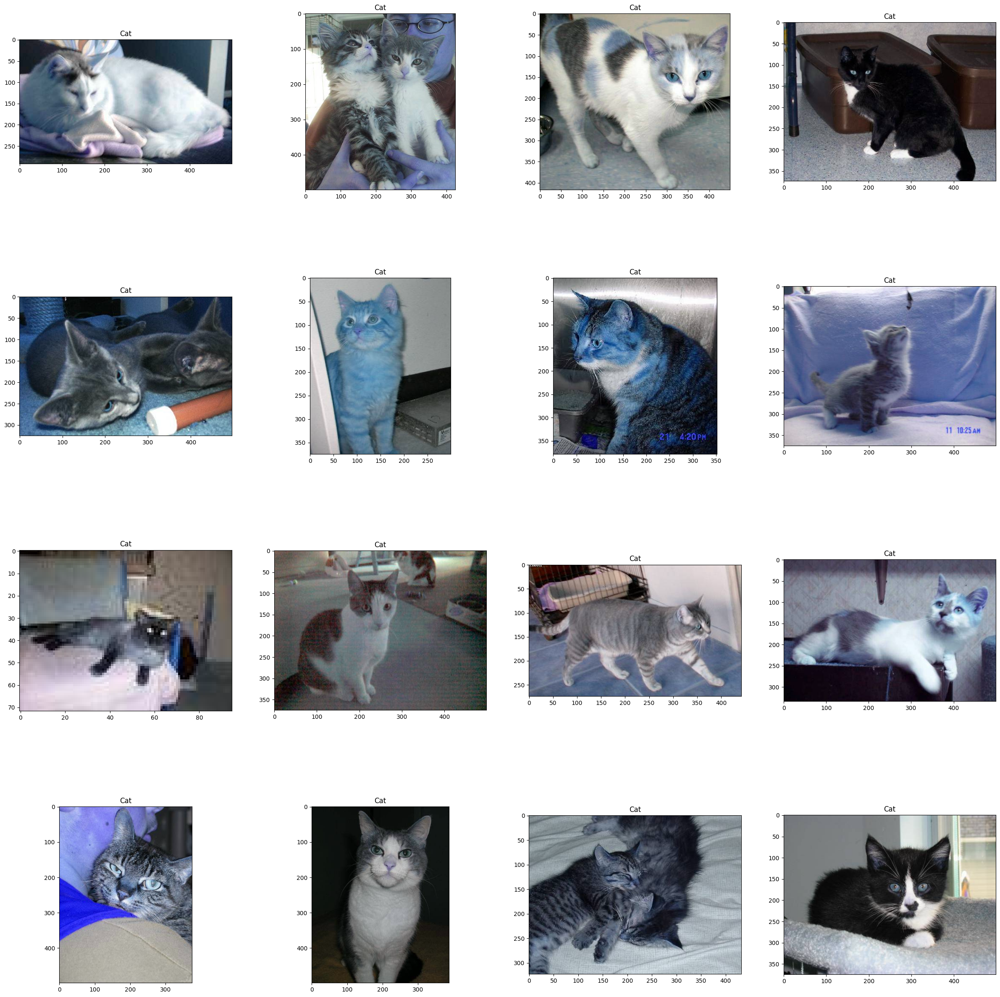

In [ ]:
#Cats in the train dataset.
plot_image(training_path, 0)

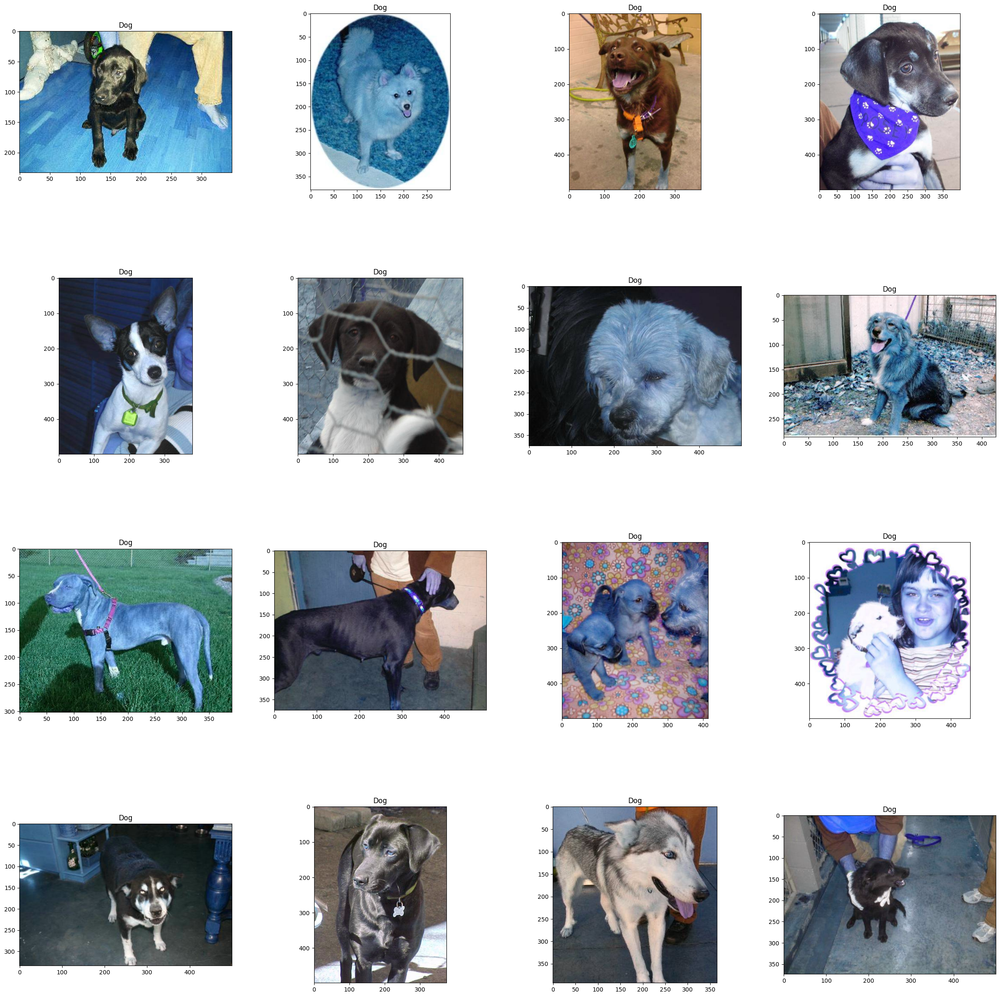

In [ ]:
#Dogs in the dataset.
plot_image(training_path, 1)

In [ ]:
# Data Augmentation
train_data=ImageDataGenerator(rescale=1./255)
test_data=ImageDataGenerator(rescale=1./255)

In [ ]:
# Fixing variables to train and test our data on
# Sửa các biến để đào tạo và kiểm tra dữ liệu trên
train_data=train_data.flow_from_directory(
            directory=training_path,
            batch_size=32,
            target_size=(48,48),
            class_mode='categorical')

test_data=test_data.flow_from_directory(
            directory=test_path,
            batch_size=32,
            target_size=(48,48),
            class_mode='categorical')

Found 8025 images belonging to 2 classes.
Found 2023 images belonging to 2 classes.


In [ ]:
# Defining CNN
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dense, Dropout, Flatten
from tensorflow.keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator

model = Sequential()

model.add(Conv2D(8, kernel_size=(3, 3), activation='relu', input_shape=(48,48,3)))

model.add(Conv2D(16, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(32, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(2, activation='sigmoid'))

In [ ]:
# Compliling the model defined above
model.compile(loss='binary_crossentropy', optimizer= 'Adam', metrics=['accuracy'])

In [ ]:
# What layers does our model have and how many parameters pass through each layer
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 46, 46, 8)         224       
                                                                 
 conv2d_1 (Conv2D)           (None, 44, 44, 16)        1168      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 22, 22, 16)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 22, 22, 16)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 20, 20, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 10, 10, 32)       0         
 2D)                                                    

In [26]:
# Fitting the model - training and validation happens here
model_info = model.fit(train_data, epochs= 20, validation_data = test_data)

Epoch 1/20
251/251 [==============================] - 77s 306ms/step - loss: 0.2262 - accuracy: 0.9024 - val_loss: 0.4257 - val_accuracy: 0.8206
Epoch 2/20
251/251 [==============================] - 72s 288ms/step - loss: 0.2280 - accuracy: 0.9054 - val_loss: 0.4452 - val_accuracy: 0.8186
Epoch 3/20
251/251 [==============================] - 79s 313ms/step - loss: 0.2197 - accuracy: 0.9085 - val_loss: 0.4531 - val_accuracy: 0.8156
Epoch 4/20
251/251 [==============================] - 64s 256ms/step - loss: 0.2269 - accuracy: 0.9099 - val_loss: 0.4186 - val_accuracy: 0.8280
Epoch 5/20
251/251 [==============================] - 62s 248ms/step - loss: 0.2102 - accuracy: 0.9115 - val_loss: 0.4176 - val_accuracy: 0.8181
Epoch 6/20
251/251 [==============================] - 65s 260ms/step - loss: 0.2243 - accuracy: 0.9053 - val_loss: 0.4567 - val_accuracy: 0.8166
Epoch 7/20
251/251 [==============================] - 61s 241ms/step - loss: 0.2183 - accuracy: 0.9120 - val_loss: 0.4442 - val_ac

In [28]:
#in kết quả
results = model.evaluate(test_data)
print('Test loss: {:4f}'.format(results[0]))
print('Test accuracy: {:4f}'.format(results[1]))

64/64 [==============================] - 9s 145ms/step - loss: 0.4640 - accuracy: 0.8225
Test loss: 0.463957
Test accuracy: 0.822541


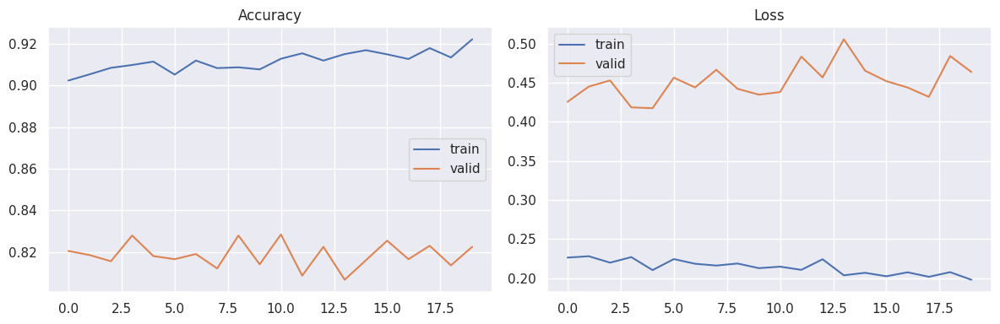

In [29]:
# Plotting a graph to see train and validation accuracy over the epochs
from matplotlib import pyplot
import seaborn as sns

sns.set()
fig = pyplot.figure(0, (12, 4))

pyplot.subplot(1, 2, 1)
sns.lineplot( model_info.history['accuracy'], label='train')
sns.lineplot( model_info.history['val_accuracy'], label='valid')
pyplot.title('Accuracy')
pyplot.tight_layout()

pyplot.subplot(1, 2, 2)
sns.lineplot( model_info.history['loss'], label='train')
sns.lineplot( model_info.history['val_loss'], label='valid')
pyplot.title('Loss')
pyplot.tight_layout()

#pyplot.savefig('epoch_history_CNN.png')
plt.savefig('./foo.png')
pyplot.show()

In [30]:
#Predicted plot of the model.

def test_model(path, model, int_type):
    pred=[]
    _path = path
    label = None
    predict_label = None
    if int_type == 0:
        _path = _path + "/" + "cats"
        label = 0
    else:
        _path = _path + "/" + "dogs"
        label = 1

    plt.figure(figsize=(30, 30))
    plt.subplots_adjust(top=None, bottom=None, left=None, right=None, wspace=0.2, hspace=0.5)
    lst_img_name = os.listdir(_path)
    for i in range(1, 17, 1):
        th = np.random.randint(0, len(lst_img_name) - 1)
        plt.subplot(4, 4, i)
        img = _path + "/" + lst_img_name[th]
        image_test = image.load_img(img, target_size=(48,48, 3))
        image_test = image.img_to_array(image_test)
        image_test = np.expand_dims(image_test, axis = 0)
        predict = model.predict(image_test)
        #pred.append(predict)

        img = cv.imread(img)
        plt.imshow(img)

        if predict[0][0] > 0.5:
            predict_label = "Predic: Dog"
            pred.append("dog")
        else:
            predict_label = "Predic: Cat"
            pred.append("cat")

        if label == 0:
            plt.title("Real: Cat" + " - " + predict_label)
        else:
            plt.title("Real: Dog" + " - " + predict_label)

1/1 [==============================] - 0s 28ms/step


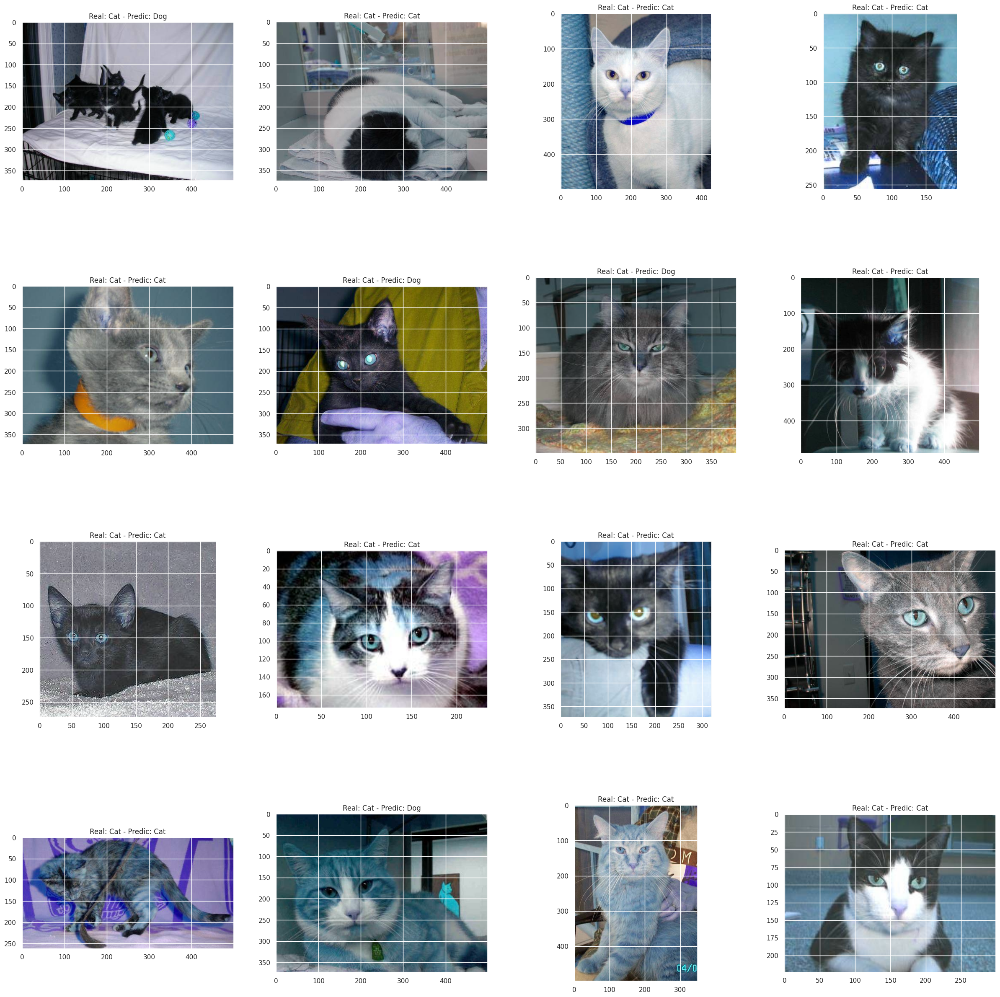

In [31]:
test_model(test_path, model, 0)

1/1 [==============================] - 0s 28ms/step


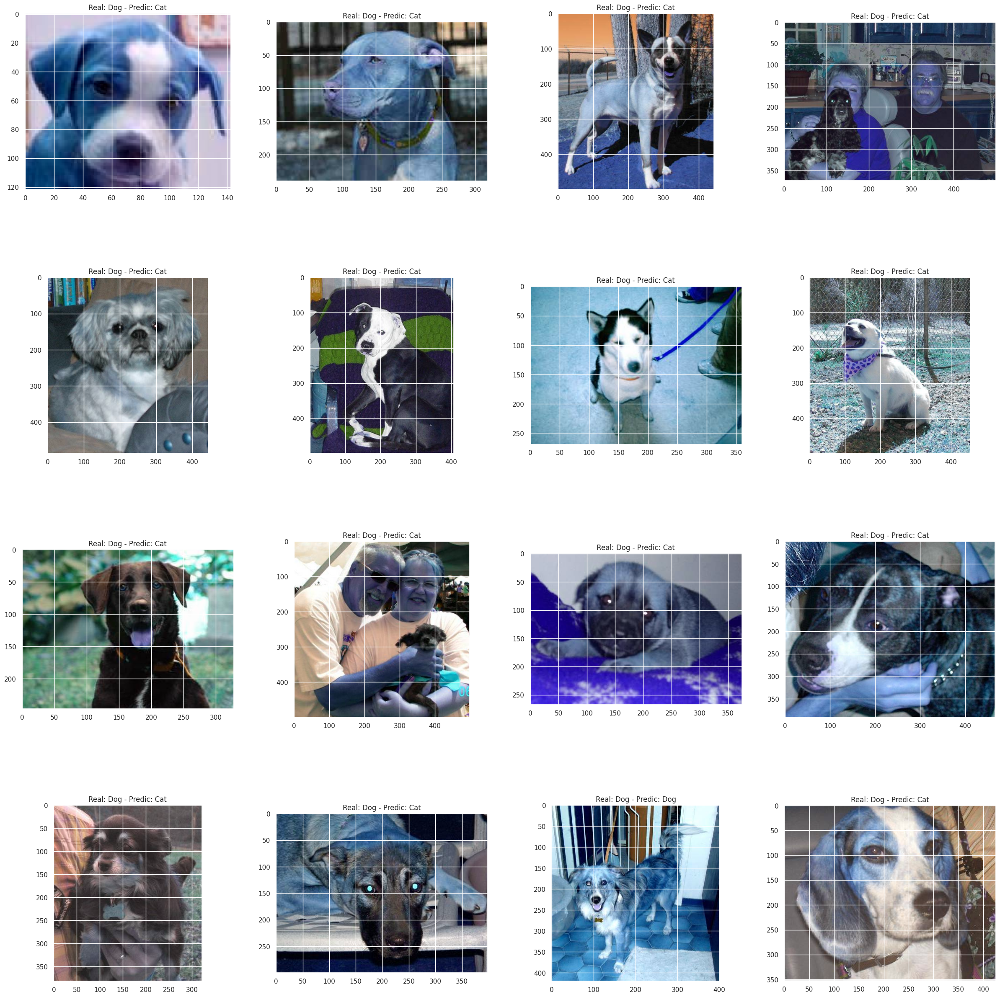

In [33]:
test_model(test_path, model, 1)